# 13-14. 프로젝트 : CIFAR-10 이미지 생성하기

GAN을 학습하는 과정은 보기보다 까다롭습니다. 모델 구조, learning_rate, 파라미터 초기화, 생성자와 판별자의 경쟁 관계, 데이터의 특성 등 고려해야 할 것이 참 많습니다.

이번에는 앞에서 배운 FASHION-MNIST 데이터 생성용 DCGAN 모델구조를 이용해서 CIFAR-10 데이터를 생성하는 모델을 직접 만들어 봅시다.
모델 구현 및 학습의 전과정의 흐름은 거의 비슷하겠지만, 아래와 같이 몇 가지 달라지는 점이 있습니다.

- 이미지 데이터의 shape가 (28, 28, 1)에서 (32, 32, 3)으로 변경됩니다. 생성자, 판별자 모델의 입출력 shape 및 모델 구조에 영향이 있습니다.
- 이미지가 단색의 grayscale에서 RGB 3채널의 컬러이미지로 변경됩니다. 시각화 과정에서 고려할 점이 있습니다.
- 입력데이터 전체 차원이 3~4배 증가하면서, 학습이 진행되는 양상이 다소 달라집니다.

### 목차
---
STEP 0. 작업환경 구성하기  
STEP 1. 데이터셋 구성하기  
STEP 2. 생성자 모델 구현하기  
STEP 3. 판별자 모델 구현하기  
STEP 4. 손실함수와 최적화 함수 구현하기  
STEP 5. 훈련과정 상세 기능 구현하기  
STEP 6. 학습 과정 진행하기  
STEP 7. (optional) GAN 훈련 과정 개선하기
STEP 8. 루브릭 & 회고

## STEP 0. 작업환경 구성하기
---
다음과 같이 작업환경을 구성합시다.
- mkdir -p ~/aiffel/dcgan_newimage/cifar10/generated_samples
- mkdir -p ~/aiffel/dcgan_newimage/cifar10/training_checkpoints
- mkdir -p ~/aiffel/dcgan_newimage/cifar10/training_history

## STEP 1. 데이터셋 구성하기
---
CIFAR-10 데이터셋도 tf.keras 안에 있는 datasets에 포함되어 있어서, 아래와 같이 손쉽게 데이터셋을 구성할 수 있습니다.

### 1-1. 데이터 불러오기 & 전처리 과정

In [1]:
import os
import glob
import time

import PIL
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from IPython import display
import matplotlib.pyplot as plt
%matplotlib inline

print("tensorflow", tf.__version__)

tensorflow 2.4.1


In [2]:
# CIFAR-10 데이터 불러오기
cifar10 = tf.keras.datasets.cifar10

(train_x, _), (test_x, _) = cifar10.load_data()

train_x.shape

(50000, 32, 32, 3)

- 분류 문제에서 와 달리, 각 이미지가 어떤 카테고리인지 나타내주는 라벨이 필요 없습니다.

- 즉, 우리가 MNIST 데이터로 분류 문제를 풀었을 때 필요했던 y_train, y_test에 해당하는 데이터를 쓰지 않기 떄문에 _ (언더스코어) 로 해당 데이터들은 무시합니다.

In [3]:
# 정규화하지 않은 상태의 데이터 pixel 상태 확인
print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 255
min pixel: 0


- cifar10는 32 x 32 픽셀의 이미지 데이터로, 각 픽셀은 0~255 값으로 이뤄져 있음을 확인 할 수 있습니다.

- 이번 프로젝트에서는 각 픽셀을 -1, 1로 정규화시켜서 사용할 예정이므로,

- 중간값을 0으로 맞춰주기 위해 127.5를 뺀 후 127.5로 나눠줍니다.

In [4]:
# 정규화 한 상태의 데이터 pixel 상태 확인
train_x = (train_x - 127.5) / 127.5 # 이미지를 [-1, 1]로 정규화합니다.

print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 1.0
min pixel: -1.0


- -1 ~ +1 값으로 정규화가 되었음을 확인 할 수 있습니다.

In [5]:
# 데이터셋의 shape 확인
train_x.shape

(50000, 32, 32, 3)

위에서 나온 결과값인 (50000, 32, 32, 3) 을 통해서,

cifar10 의 train 데이터셋에 5만장의 이미지가 들어 있으며, 32 x 32 의 이미지 사이즈와 컬러 이미지로 R, G, B 라는 3개의 채널을 가지고 있음을 확인 할 수 있습니다.

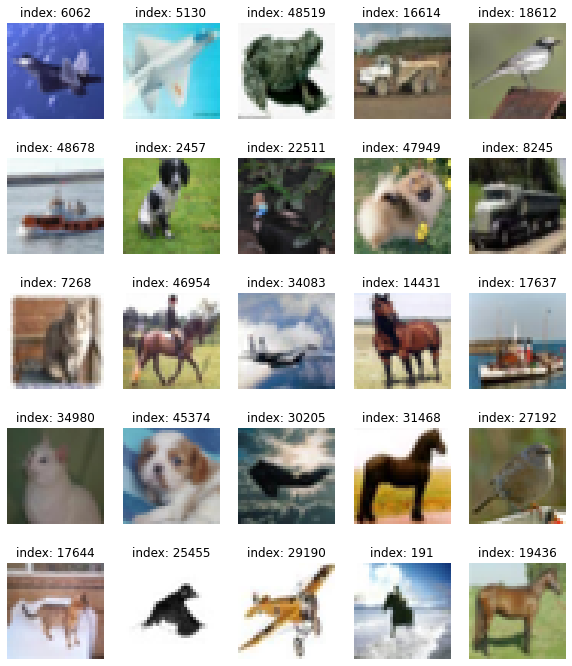

In [6]:
# 데이터셋에서 이미지 랜덤 추출

plt.figure(figsize=(10, 12))  # 이미지의 전체 프레임의 크기를 결정

for i in range(25):
    plt.subplot(5, 5, i+1)  # 여러 개의 이미지를 한 번에 띄우고 싶을 때에는 plt.subplot(row, col, index)의 형태로 볼 수 있습니다.
    rand_index = np.random.randint(1, 50000)
    plt.imshow((train_x[rand_index]+1)/2)
    plt.title(f'index: {rand_index}')
    plt.axis('off')
plt.show()

맨 첫 줄의 plt.figure(figsize=(10, 12))는 이미지의 전체 프레임의 크기를 결정합니다.

또한 여러 개의 이미지를 한 번에 띄우고 싶을 때에는 plt.subplot(row, col, index)의 형태로 볼 수 있습니다.

25개의 이미지를 5x5의 배열 형태로 보고 싶은 경우, plt.subplot(5, 5, index)로 작성하면 되는 거죠. index는 1부터 10까지 순서대로 바뀌어야 하니 for문에서 사용하는 i에 1을 i+1을 넣어주면 됩니다. (i는 range(10)으로 꺼냈으니 0~9의 숫자로 반복되죠)

추가적으로 plt.title('title') 함수를 이용해서 이미지에 제목으로 라벨 값을 넣어줬고, plt.axis('off') 함수로 불필요한 축을 지워서 깔끔하게 나타내는 식으로 데이터에 대한 전처리를 모두 마쳤습니다.

### 1-2. Hyperparameter 설정

In [7]:
BUFFER_SIZE = 50000
BATCH_SIZE = 256

- BUFFER_SIZE은 전체 데이터를 섞기 위해 50,000으로 설정합니다.
- shuffle() 함수가 데이터셋을 잘 섞어서 모델에 넣어줄 것입니다.


- BATCH_SIZE는 모델이 한 번에 학습할 데이터의 양입니다.
- 너무 많은 양을 한 번에 학습시키면 메모리 활용 면에서도 비효율적이고, 한 번 학습을 하는 데에도 오래 걸리므로 적절한 사이즈로 잘라서 학습을 진행하는 방식인 미니 배치 학습을 사용합니다.

### 1-3. 텐서플로우의 텐서 자료형으로 데이터셋 만들기

In [8]:
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

tf.data.Dataset 모듈의 from_tensor_slices() 함수를 사용하면 리스트, 넘파이, 또는 텐서플로우의 텐서 자료형에서 데이터셋을 만들 수 있습니다.

위 코드는 train_x라는 넘파이 배열(numpy ndarray)형 자료를 섞고, 이를 배치 사이즈에 따라 나누도록 합니다. 데이터가 잘 섞이게 하기 위해서는 버퍼 사이즈를 총 데이터 사이즈와 같거나 크게 설정하는 것이 좋습니다.

## STEP 2. 생성자 모델 구현하기
---
- (32, 32, 3)의 shape를 가진 이미지를 생성하는 생성자 모델 구현 함수를 작성해 봅시다.
- noise = tf.random.normal([1, 100])로 생성된 랜덤 노이즈를 입력으로 하여 방금 구현한 생성자로 랜덤 이미지를 생성해 봅시다.
- 생성된 랜덤 이미지가 생성자 출력 규격에 잘 맞는지 확인해 봅시다.

In [9]:
def make_generator_model():

    # Start
    model = tf.keras.Sequential()

    # First: Dense layer
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Second: Reshape layer
    model.add(layers.Reshape((8, 8, 256)))

    # Third: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(1, 1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False, \
                                     activation='tanh'))

    return model

make_generator_model이라는 함수를 만들어서 언제든 생성자를 생성할 수 있도록 했습니다.

함수 내부에서는 먼저 tf.keras.Sequential()로 모델을 시작한 후 레이어를 차곡차곡 쌓아줍니다.

여기에서 가장 중요한 레이어는 바로 Conv2DTranspose 레이어입니다. Conv2DTranspose 층은 일반적인 Conv2D와 반대로 이미지 사이즈를 넓혀주는 층입니다. 이 모델에서는 세 번의 Conv2DTranspose 층을 이용해 (7, 7, 256) → (14, 14, 64) → (28, 28, 1) 순으로 이미지를 키워나갑니다. 여기서 최종 사이즈인 (28, 28, 1)은 우리가 준비했던 데이터셋과 형상이 동일합니다.

레이어의 사이사이에 특정 층들이 반복되는 것을 확인할 수 있는데, BatchNormalization 레이어는 신경망의 가중치가 폭발하지 않도록 가중치 값을 정규화시켜줍니다. 또한 중간층들의 활성화 함수는 모두 LeakyReLU를 사용하였습니다. 다만 마지막 층에는 활성화 함수로 tanh를 사용하는데, 이는 우리가 -1 ~ 1 이내의 값으로 픽셀 값을 정규화시켰던 데이터셋과 동일하게 하기 위함입니다.

In [10]:
generator = make_generator_model()

generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 16384)             1638400   
_________________________________________________________________
batch_normalization (BatchNo (None, 16384)             65536     
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 16384)             0         
_________________________________________________________________
reshape (Reshape)            (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 8, 8, 128)         819200    
_________________________________________________________________
batch_normalization_1 (Batch (None, 8, 8, 128)         512       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 8, 8, 128)         0

그럼 모델이 만들어졌으니, shape=(1, 100)의 형상을 가지는 랜덤 노이즈 벡터를 생성해서 결과물을 한번 만들어 보도록 하겠습니다. 아직 모델이 학습되지 않았으니, 아마 결과물도 큰 의미가 있지는 않을 것입니다.

tf.random.normal을 이용하면 가우시안 분포에서 뽑아낸 랜덤 벡터로 이루어진 노이즈 벡터를 만들 수 있습니다.

In [11]:
# 노이즈를 생성합니다.
noise = tf.random.normal([1, 100]) # tf.random.normal을 이용하면 가우시안 분포에서 뽑아낸 랜덤 벡터로 이루어진 노이즈 벡터를 만들 수 있습니다.
generated_image = generator(noise, training=False) # 지금은 학습하는 중이 아니니 training=False를 설정해 주어야 합니다!
generated_image.shape

TensorShape([1, 32, 32, 3])

- [1, 32, 32, 3] 사이즈의 이미지가 잘 생성 되었군요!

- 첫 번째 1은 1개(batch_size=1)라는 뜻을, 그 뒤로는 (32, 32, 1) 사이즈 이미지가 생성되었다는 뜻을 가집니다.

matplotlib 라이브러리는 2차원 이미지만 보여줄 수 있으므로 0번째와 3번째 축의 인덱스를 0으로 설정해서 (28, 28) shape의 이미지를 꺼낼 수 있도록 해야 합니다.

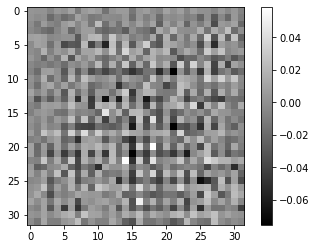

In [12]:
# 생성 노이즈 이미지 확인해보기
plt.imshow(generated_image[0, :, :, 0], cmap='gray')
plt.colorbar()
plt.show()

역시 -1과 1 사이의 값에서 적당히 잘 생성된 것을 확인할 수 있습니다.

아직은 모델이 전혀 학습하지 않은 상태이기 때문에 아무런 의미가 없는 노이즈 같은 이미지가 생성되었지만, 모델이 점차 학습해 나가며 제대로 된 이미지를 생성하기를 바라봅니다.

## STEP 3. 판별자 모델 구현하기
---
- (32, 32, 3)의 이미지를 입력으로 받아 1dim을 판별결과를 출력하는 판별자 모델 구현 함수를 작성해 봅시다.
- 위 STEP 2에서 생성한 랜덤 이미지를 판별자 모델이 판별한 결과값을 확인해 봅시다.

In [13]:
def make_discriminator_model():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    # Second: Conv2D Layer
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    # Third: Flatten Layer
    model.add(layers.Flatten())

    # Fourth: Dense Layer
    model.add(layers.Dense(1))

    return model

판별자 또한 make_discriminator_model 함수로 구현하였습니다.

Conv2DTranspose 층을 사용해서 이미지를 키워나갔던 생성자와 반대로, 판별자는 Conv2D 층으로 이미지의 크기를 점점 줄여나갑니다. 첫 번째 Conv2D 층에서 입력된 [28, 28, 1] 사이즈의 이미지는 다음 층을 거치며 (28, 28, 1) → (14, 14, 64) → (7, 7, 128)까지 줄어들게 됩니다.

마지막에는 Flatten 층을 사용해 3차원 이미지를 1차원으로 쭉 펴서 7x7x128=6272, 즉 (1, 6272) 형상의 벡터로 변환합니다. 이는 생성자의 Reshape 층에서 1차원 벡터를 3차원으로 변환했던 것과 정확히 반대 역할을 합니다. 1차원 벡터로 변환한 후에는 마지막 Dense Layer를 거쳐 단 하나의 값을 출력하게 됩니다.

그럼 판별 모델을 discriminator라는 변수 이름으로 생성하고, 모델 세부 내용인 summary를 출력해 봅시다.

In [14]:
discriminator = make_discriminator_model()

discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 16, 16, 64)        4864      
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 16, 16, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 8, 8, 128)         204928    
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 8, 8, 128)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 8, 8, 128)         0         
_________________________________________________________________
flatten (Flatten)            (None, 8192)             

그렇다면 아까 생성했던 가짜 이미지를 판별자에 입력시키면 어떤 결과가 나올까요? 바로 확인해 봅시다.

In [15]:
decision = discriminator(generated_image, training=False)
decision

<tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[-0.00295983]], dtype=float32)>

텐서플로우의 텐서 형태로 출력이 되었습니다. 이 값 또한 아직은 아무런 의미가 없는 값일 것입니다.

## STEP 4. 손실함수와 최적화 함수 구현하기
---
- 생성자와 판별자의 손실함수(loss)를 구현해 봅시다.
- 판별자의 출력값을 가지고 실제/생성(real/fake) 이미지 판별 정확도(accuracy)를 계산하는 함수를 구현해 봅시다.
- 생성자와 판별자를 최적화하는 optimizer를 정의합니다.

### 4-1. Cross Entropy

GAN은 손실함수로 교차 엔트로피(Cross Entropy)를 사용합니다.

Cross Entropy는 앞서 분류 모델을 설계할 때 많이 사용했던 손실함수이죠. 점점 가까워지기 원하는 두 값이 얼마나 큰 차이가 나는지를 정량적으로 계산할 때 많이 쓰입니다.

특히 판별자는 한개의 이미지가 진짜인지 가짜인지 2개의 클래스 분류 문제를 풀어야하므로, 이진 교차 엔트로피(binary cross entropy)를 사용한다.

In [16]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

그럼, 이제 cross_entropy를 활용해 계산할 loss들은 fake_output와 real_output, 두 가지를 활용합니다.

- fake_output : 생성자가 생성한 Fake Image를 구분자에 입력시켜서 판별된 값, 즉 D(fake_image)
- real_output : 기존에 있던 Real Image를 구분자에 입력시켜서 판별된 값, 즉 D(real_image)

### 4-2. generator_loss

생성자의 손실함수는 감별자를 얼마나 잘 속였는지에 대해 수치화를 합니다.

- generator_loss는 fake_output과 1에 가까워져야 하므로 tf.ones_like와의 cross_entropy 값을 계산하면 됩니다.

- 즉, fake_output이 1에 가까울수록 작은 값을 가집니다.

In [17]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

### 4-3. discriminator_loss

반면 판별자의 손실함수는 가짜이미지 와 진짜 이미지를 잘 판단하는지에 대해 수치화 합니다.
(real_output은 1에 가까워지고, fake_output은 0에 가까워지게)

- discriminator_loss에서 real_output 값은 1에 가까워져야 하고 fake_output은 0에 가까워져야 함.(두 가지 loss값을 모두 계산)

In [18]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

### 4-4. discriminator accuracy
- real output / fake output를 얼마나 정확히 판별하는지 accuracy 계산
- 두 accuracy를 따로 계산하여 확인
- real output / fake output는 accuracy가 1에 가까우면 좋지 않음
- 초반에는 1.0에서 시작하다가 서서히 낮아져서 0.5에 가까워지는 것이 좋음.

In [19]:
def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

### 4-5. 최적화 함수 (optimizer)

그럼 손실함수는 모두 설계가 되었고, 이제 최적화 함수를 설정할 차례입니다. 이번에는 Adam 최적화 기법 을 활용해 보겠습니다.

문과생도 이해하는 딥러닝 (8) - 신경망 학습 최적화 (https://sacko.tistory.com/42)

중요한 하이퍼 파라미터인 "learning rate"는 0.0001로 설정할 텐데, 학습 품질을 올려보고 싶다면 여러 가지로 값을 바꾸어 가며 학습을 진행해 보는 것을 추천합니다.

또한, 중요한 점 한 가지는 생성자와 구분자는 따로따로 학습을 진행하는 개별 네트워크이기 때문에 optimizer를 따로 만들어주어야 한다는 점입니다.

In [20]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4) # e-4 = 0.0001
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

### 4-6. 훈련과정 상세 기능 구현하기

In [21]:
# 매번 학습이 어떻게 진행되는지 확인을 위해 생성자가 생성한 샘플을 확인
noise_dim = 100  # 고정된 100차원의 noise 설정 
num_examples_to_generate = 16  # sample의 개수

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

TensorShape([16, 100])

- 생성할 샘플은 매번 같은 노이즈로 생성해야 그에 대한 진전 과정을 확인할 수 있으므로, 고정된 seed 노이즈를 만들어두어야 합니다.

- 즉, 100차원의 노이즈를 총 16개, (16, 100) 형상의 벡터를 만들어 두도록 합니다.

### STEP 5. 훈련과정 상세 기능 구현하기
---
- 1개 미니배치의 훈련 과정을 처리하는 train_step() 함수를 구현해 봅시다.
- 16개의 고정된 seed를 입력으로 하여 훈련 과정 동안 생성한 이미지를 시각화하는 generate_and_save_images() 함수를 구현해 봅시다.
- 훈련 epoch마다 생성자/판별자의 loss 및 판별자의 실제/생성(real/fake) 이미지 판별 accuracy 히스토리(history)를 그래프로 시각화하는 draw_train_history() 함수를 구현해 봅시다.
- training_checkpoints 디렉토리에 몇 epoch마다 모델을 저장하는 checkpoint 모듈을 설정해 봅시다.

In [22]:
@tf.function
def train_step(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:  #(3) tf.GradientTape() 오픈
        generated_images = generator(noise, training=True)  #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리턴값

- (1) 입력데이터: Real Image 역할을 할 images 한 세트를 입력으로 받음
- (2) 생성자 입력 노이즈 : generator가 FAKE IMAGE를 생성하기 위한 noise를 images 한 세트와 같은 크기인 BATCH_SIZE 만큼 생성함
- (3) tf.GradientTape()는 가중치 갱신을 위한 Gradient를 자동 미분으로 계산하기 위해 with 구문 열기
- (4) generated_images 생성 : generator가 noise를 입력받은 후 generated_images 생성
- (5) discriminator 판별 : discriminator가 Real Image인 images와 Fake Image인 generated_images를 각각 입력받은 후 real_output, fake_output 출력
- (6) loss 계산 : fake_output, real_output으로 generator와 discriminator 각각의 loss 계산
- (7) accuracy 계산 : fake_output, real_output으로 discriminator가 accuracy 계산
- (8) gradient 계산 : gen_tape와 disc_tape를 활용해 gradient를 자동으로 계산
- (9) 모델 학습 : 계산된 gradient를 optimizer에 입력해 가중치 갱신
- (10) 리턴값 : 이번 스텝에 계산된 loss와 accuracy를 리턴

이러한 일련의 과정을 통해 한 번의 train_step이 끝나게 됩니다.

그러면, 이렇게 한 단계씩 학습할 train_step과 함께 일정 간격으로 학습 현황을 볼 수 있는 샘플을 생성하는 함수를 만들어 보죠. 아까 만들어 놓았던 고정된 seed를 이용해서 결과물을 만들어내므로, 고정된 seed에 대한 결과물이 얼마나 나아지고 있는지를 확인할 수 있습니다.

In [23]:
def generate_and_save_images(model, epoch, it, sample_seeds):

    predictions = model(sample_seeds, training=False)

    np_predictions = predictions.numpy()
    np_predictions = (np_predictions * 127.5) + 127.5 # 정규화 했던 것을 되돌리기
    np_predictions = np_predictions.astype(int)   
    
    
    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow(np_predictions[i])
        plt.axis('off')

    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample_epoch_{:04d}_iter_{:03d}.png'
                    .format(os.getenv('HOME'), epoch, it))

    plt.show()

model이 16개의 seed가 들어있는 sample_seeds를 입력받아서 만들어낸 prediction을 matplotlib으로 시각화해주는 과정이 담겨 있는데, 어딘가 익숙하지 않나요?

바로 우리가 위에서 해봤던, subplot을 이용해서 총 16개의 sample을 시각화하는 과정입니다. 16개이므로 4행 4열로 나누어 subplot(4, 4, i+1)로 시각화하는 것이죠.

또한, plt에 저장되어 보이는 이미지를 plt.savefig로 간단히 파일로 저장합니다.

학습 과정을 체크하기 위해 시각화해 보아야 할 중요한 것으로 loss와 accuracy 그래프를 빼놓을 수 없겠습니다. GAN의 학습 과정은 지도학습 모델보다 까다로운데, 이것은 두 모델이 서로의 학습 과정에 영향을 주고받기 때문입니다. train_step() 함수가 리턴하는 gen_loss, disc_loss, real_accuracy, fake_accuracy 이상 4가지 값을 history라는 dict 구조에 리스트로 저장하고 있다가 매 epoch마다 시각화하는 함수를 만들어 봅시다. 예를 들어 생성자의 loss의 history는 history['gen_loss']로 접근할 수 있는 list로 관리할 예정입니다.

In [24]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 10    # matlab 차트의 기본 크기를 15,10으로 지정해 줍니다.

def draw_train_history(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/training_history/train_history_{:04d}.png'
                    .format(os.getenv('HOME'), epoch))
    plt.show()

다음은 정기적으로 모델을 저장하기 위한 checkpoint를 만들어줍니다.

tf.train.Checkpoint를 활용하면 매번 모델을 직접 저장해 주지 않아도, 코드 한 줄로 빠르고 편하게 버전 관리를 할 수 있습니다. 모델이 복잡해지고 학습 속도가 오래 걸릴수록, 모델에 대한 저장 및 버전 관리는 필수적입니다. 아주 오랜 시간 동안 학습을 시켰는데 네트워크가 끊긴다거나, 예상치 못한 문제로 인해 모델을 잃어버린다면 그보다 끔찍한 일은 없을 테니까요..!

checkpoint에는 optimizer와 생성자, 판별자를 모두 넣어 저장합니다. 정확히는 생성자와 판별자가 학습한 모델 가중치를 저장하는 것이죠. 게임의 체크포인트처럼 우리의 학습 환경과 학습한 내용을 저장해 둡니다.

checkpoint 모델을 저장하기 위해 작업환경 내에 training_checkpoints 라는 디렉토리를 사용하겠습니다.

In [25]:
# model checkpoint
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

### STEP 6. 학습 과정 진행하기
---
- 위 STEP 5에서 구현한 기능들을 활용하여 최소 50 epoch만큼의 모델 학습을 진행해 봅시다.
- 학습 과정에서 생성된 샘플 이미지로 만든 gif 파일을 통해 학습 진행 과정을 시각적으로 표현해 봅시다.
- 학습 과정을 담은 샘플 이미지, gif 파일, 학습 진행 그래프 이미지를 함께 제출합니다.

(참고) 학습 과정 중 학습 epoch를 추가 진행해야 하거나, 학습한 모델을 활용하여 이미지를 생성할 필요가 생깁니다. 그럴 때마다 모델 학습을 처음부터 다시 진행한다면 시간 낭비가 될 것입니다.

우리는 위에서 checkpoint 모듈을 이용해 모델을 저장해 둔 바 있습니다. 이를 이용해 학습해 둔 모델을 로드하면 모델 재학습이 필요 없이 이런 작업을 진행할 수 있습니다.
아래는 checkpoint 모듈을 활용하여 모델을 로드하는 예시입니다.

In [26]:
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

여기서부터는 정말 별로 특별한 것이 없습니다. 우리가 생성된 샘플을 시각화하거나 원하는 시간을 출력하는 것뿐이니까요. 출력하고자 하는 print문과 몇 번마다 출력하는지에 대한 구문을 원하는 대로 수정해서 마음에 드는 형태로 확인해 보세요!

그러면 모델을 저장하는 간격을 담당하는 save_every와 전체 학습 에포크를 결정하는 EPOCHS 파라미터도 설정해 준 후 훈련시켜 보도록 하겠습니다!

본 학습은 이미지를 활용한 것이기 때문에 CPU 환경에서는 매우 느릴 수 있습니다. RTX2070 또는 구글 Colab의 T4 정도 사양의 경우 1 Epoch 당 10초가 걸리는 반면, 일반적인 CPU 환경에서는 최소 3분에서 10분 이상이 걸릴 수 있으므로 최대한 GPU 환경에서 실습해 보는 것을 추천합니다.

이제 다음과 같이 train() 함수를 실행시키면 드디어 모델이 학습해 나가면서 만들어내는 결과물을 실시간으로 확인할 수 있습니다!

### 6-1. (빠른 진행을 위한 수정 값) lr = 0.001, epoch = 10 

In [27]:
save_every = 5
EPOCHS = 10

# 사용가능한 GPU 디바이스 확인
tf.config.list_physical_devices("GPU")

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

checkpoint를 통해 모델이 로드되었으면 아래 코드를 실행할 경우 로드된 모델의 파라미터 상태에서 훈련을 재개할 수도 있습니다.

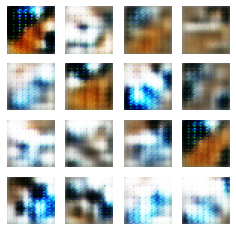

Time for training : 313 sec


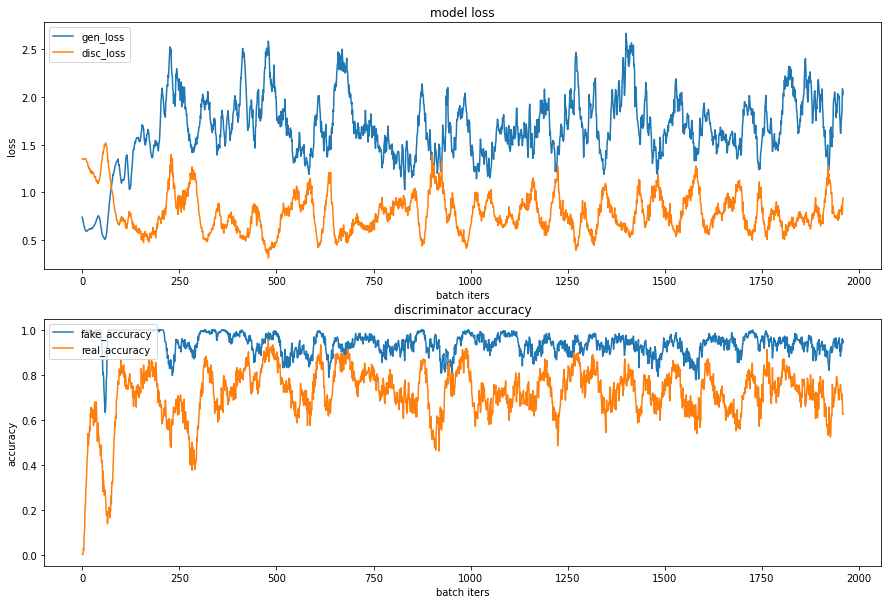

CPU times: user 3min 50s, sys: 1min 20s, total: 5min 11s
Wall time: 5min 14s


In [28]:
%%time
train(train_dataset, EPOCHS, save_every)

# 학습과정의 loss, accuracy 그래프 이미지 파일이 ~/aiffel/dcgan_newimage/fashion/training_history 경로에 생성되고 있으니
# 진행 과정을 수시로 확인해 보시길 권합니다.

학습이 성공적으로 진행 되었는지에 대한 척도로는, 생성자가 만든 Fake Image에 대한 판별자의 Accuracy(fake_accuracy)가 1에서 멀어질수록 학습이 성공적으로 진행 되었음을 의미 합니다.

즉, 위의 그래프를 보면 fake_accuracy (성공률)이 1에 가깝게 유지 되고 있으므로, 생성자가 만든 이미지가 아직 판별자를 성공적으로 속이지 못하고 있다는 뜻입니다.

In [29]:
anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_00.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l ~/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_00.gif

-rw-r--r-- 1 root root 2440391 Nov 14 12:23 /aiffel/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_00.gif


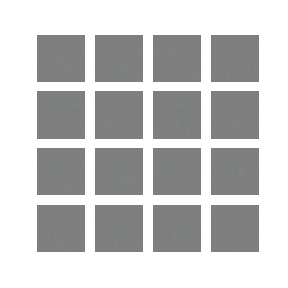

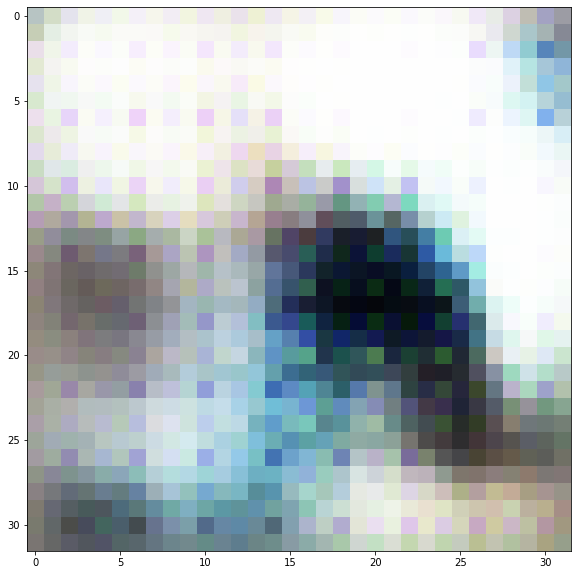

In [30]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

# 로드한 모델이 정상적으로 이미지를 생성하는지 확인해 봅니다. 
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

np_generated = generated_image.numpy()
np_generated = (np_generated * 127.5) + 127.5   # reverse of normalization
np_generated = np_generated.astype(int)
plt.imshow(np_generated[0])
plt.show()  # 정상적으로 모델이 로드되었다면 랜덤 이미지가 아니라 CIFAR-10 이미지가 그려질 것입니다.

- 프로젝트의 마지막 모델링 진행 중에 끊겨서 epoch = 10으로 진행을 하게 되었는데, epoch 값이 낮으면, 어떤 결과가 나오는지 알게 되는 계기가 되었습니다.

### 6-2. 초기 설정 값 lr = 0.001, epoch = 50 (리사이클 과정에서 그래프 소멸...)

In [ ]:
save_every = 5
EPOCHS = 50

# 사용가능한 GPU 디바이스 확인
tf.config.list_physical_devices("GPU")

In [43]:
anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_01.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l ~/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_01.gif

-rw-r--r-- 1 root root 1770591 Nov 14 10:24 /aiffel/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_01.gif


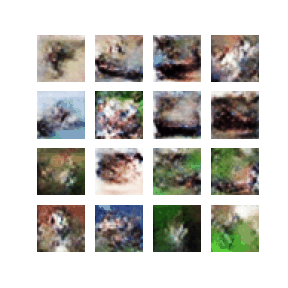

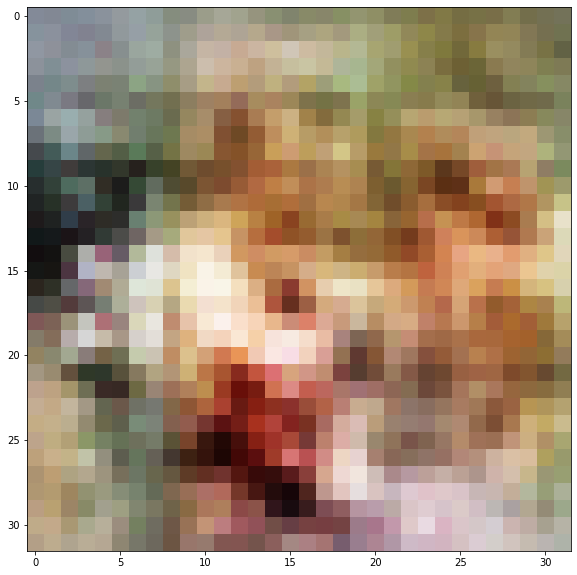

In [32]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

# 로드한 모델이 정상적으로 이미지를 생성하는지 확인해 봅니다. 
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

np_generated = generated_image.numpy()
np_generated = (np_generated * 127.5) + 127.5   # reverse of normalization
np_generated = np_generated.astype(int)
plt.imshow(np_generated[0])
plt.show()  # 정상적으로 모델이 로드되었다면 랜덤 이미지가 아니라 CIFAR-10 이미지가 그려질 것입니다.

- save_every = 5 / EPOCHS = 50 라는 학습으로는 CIFAR-10 의 명확한 이미지를 확인 하기가 어렵다는 것을 알 수 있습니다.
- 우선 에폭을 증가시켜 모델링을 진행해 보고 결과를 확인해보도록 하겠습니다.

## STEP 7. (optional) GAN 훈련 과정 개선하기
---
- STEP 6을 진행하면서 생성된 샘플 이미지, 학습 과정 그래프 등을 통해 이전 훈련 과정의 문제점을 분석해 봅시다.
- 모델구조 또는 학습 과정을 개선한 내역과 그 결과(샘플 이미지, 학습 과정 그래프 포함)를 함께 제출합니다.

(참고) 아래 언급된 페이지들에서 개선을 위한 아이디어를 얻을 수 있을 것입니다.

- How to Train a GAN? Tips and tricks to make GANs work (https://github.com/soumith/ganhacks)

- 10 Lessons I Learned Training GANs for one Year (https://towardsdatascience.com/10-lessons-i-learned-training-generative-adversarial-networks-gans-for-a-year-c9071159628)

- Tips for Training Stable Generative Adversarial Networks (https://machinelearningmastery.com/how-to-train-stable-generative-adversarial-networks/)

- Improved Techniques for Training GANs(paper) (https://proceedings.neurips.cc/paper/2016/file/8a3363abe792db2d8761d6403605aeb7-Paper.pdf)


### 7-1. 개선 1 (lr = 0.001, epoch = 100)

In [33]:
save_every = 5
EPOCHS = 100

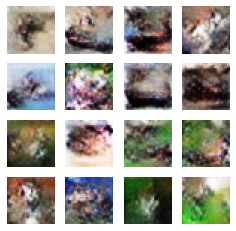

Time for training : 3021 sec


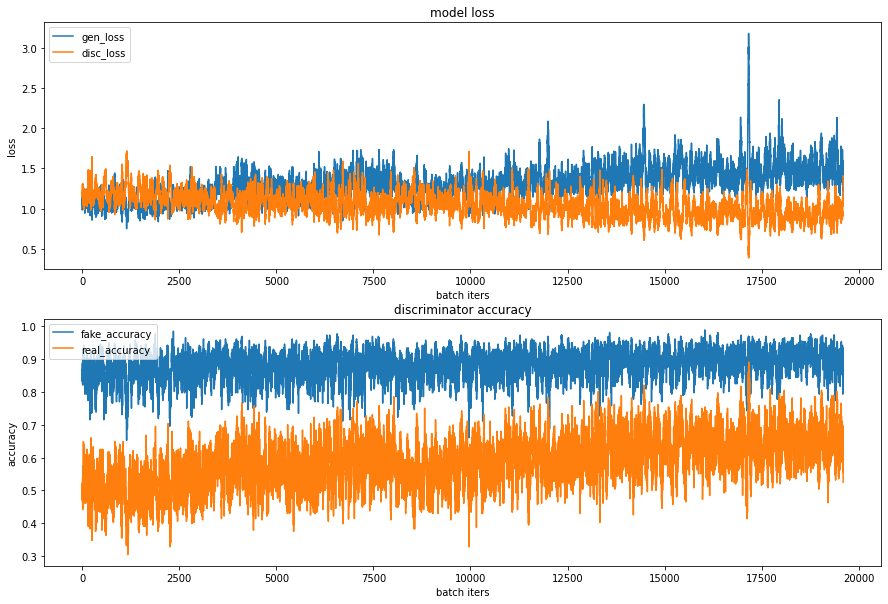

CPU times: user 39min 8s, sys: 12min 1s, total: 51min 10s
Wall time: 50min 23s


In [35]:
%%time
train(train_dataset, EPOCHS, save_every)

- epoch를 50에서 100으로 증가하였으나, fake_accuracy 가 0.8~1.0을 진동하는 것을 보면 추가적인 변수를 조정해야함을 확인 할 수 있습니다.

In [44]:
anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_02.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l ~/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_02.gif

-rw-r--r-- 1 root root 1770591 Nov 14 10:24 /aiffel/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_02.gif


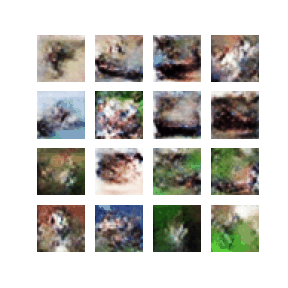

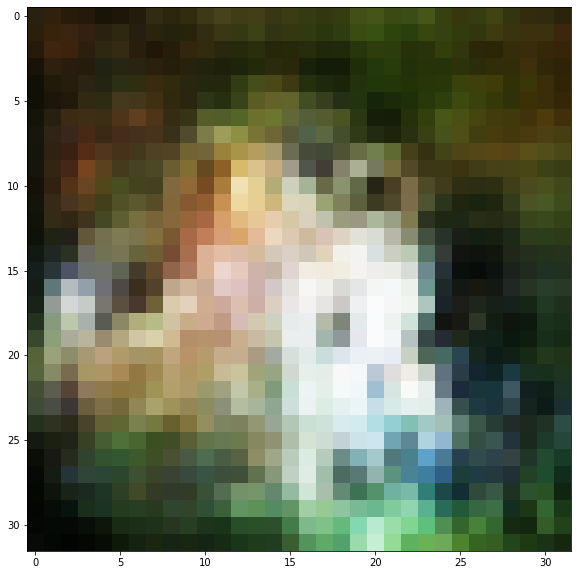

In [38]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

# 로드한 모델이 정상적으로 이미지를 생성하는지 확인해 봅니다. 
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

np_generated = generated_image.numpy()
np_generated = (np_generated * 127.5) + 127.5   # reverse of normalization
np_generated = np_generated.astype(int)
plt.imshow(np_generated[0])
plt.show()  # 정상적으로 모델이 로드되었다면 랜덤 이미지가 아니라 CIFAR-10 이미지가 그려질 것입니다.

- 이미지를 보아도 epoch 수를 100으로 늘려서 이전 보다 더 디테일 해진 것 같으나, 아직 정확하게 분간 되지는 않았습니다

### 7-2. 개선 2 (lr = 0.002, epoch = 50)

- 성능 향상을 위한 방도를 찾아보다가, 위에서 adam optimizer의 learning rate를 조정해 보는 것도 방법이라는 것을 확인 후 lr 값을 2e-4로 수정 후 모델링 진행을 해보겠습니다.

In [39]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4)

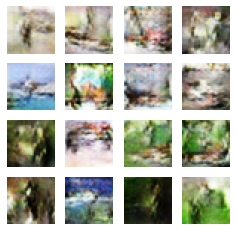

Time for training : 1497 sec


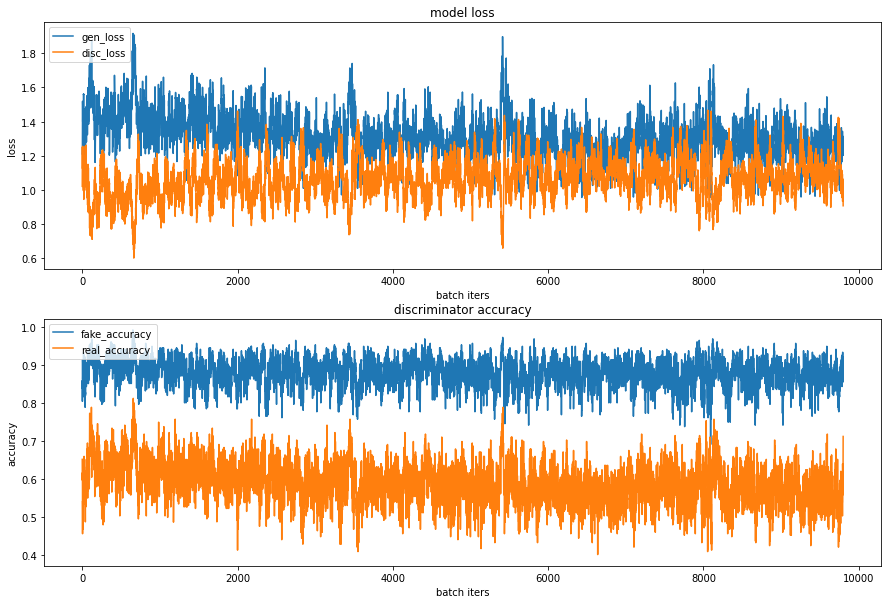

In [40]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

save_every = 5
EPOCHS = 50

train(train_dataset, EPOCHS, save_every)

- epoch가 100에서 50으로 감소하였으나, lr을 조정 하는 것 만으로도 epoch를 100으로 했던 것 만큼 fake_accuracy 가 0.8~1.0을 진동하는 것을 보면 lr이 fake_accuracy에 영향을 준다는 것을 확인 할 수 있습니다.

In [41]:
anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_03.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l ~/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_03.gif

-rw-r--r-- 1 root root 1770591 Nov 14 10:22 /aiffel/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_03.gif


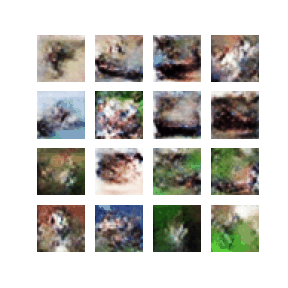

### 7-3. 개선 3 (lr = 0.001, epoch = 500)

- (번외) epoch 수를 500으로 돌리다가 인터넷 연결이 끊기는 불상사가 발생하면서... 처음부터 돌리기엔 시간이 부족할 것으로 판단하여, 남겨진 쥬피터 기록으로 대체하고 아래의 코드만 돌리는 것으로 진행하였습니다. 돌리고 난 이후에 생각을 해보니, 앞에서checkpoint에서 진행한 결과 값을 잃어버리고 돌린 것이어서 유의미한 결과값은 낸 것인지에 대한 우려를 가지곤 있으나 우선 진행해 보도록 하겠습니다.

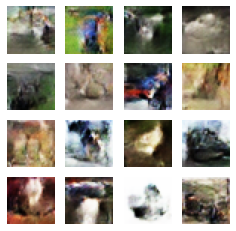

Time for training : 15649 sec


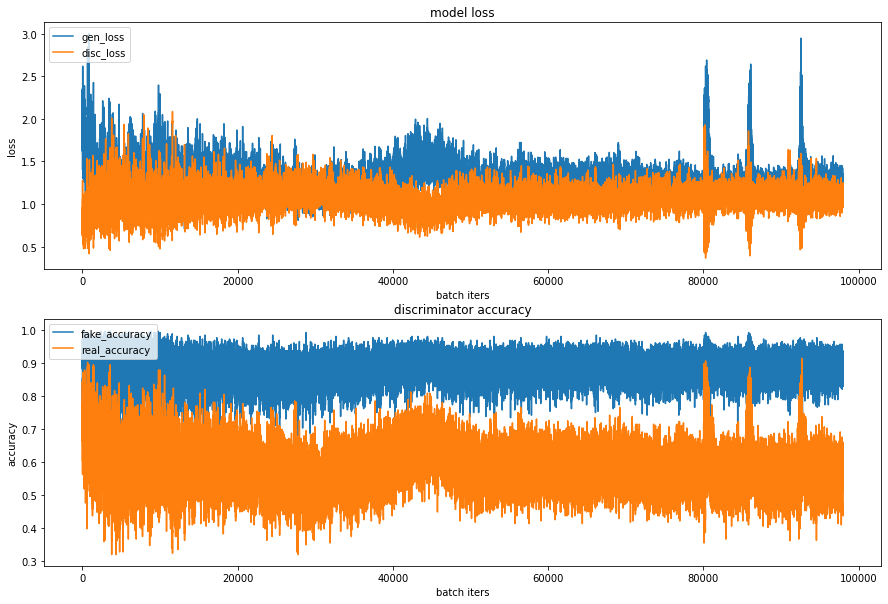

In [31]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

save_every = 5
EPOCHS = 500

train(train_dataset, EPOCHS, save_every)

- epoch수가 매우 늘어난 만큼 더 좋은 결과가 나온 거 같습니다.

In [32]:
anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_04.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l ~/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_04.gif

-rw-r--r-- 1 root root 3998536 Nov 14 17:11 /aiffel/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_04.gif


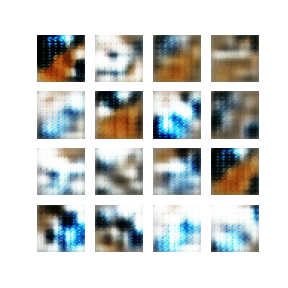

- 맨 처음 시도와 비교하면 형태가 있긴하나 원본 이미지보다는 나아진 것같습니다.
- 하이퍼파라미터 변경 외에 변경 가능한 파라미터를 찾아서 다른 시도가 필요할 것으로 보입니다.

### 7-4. 개선 4 (lr = 0.002, epoch = 600)

In [33]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4)

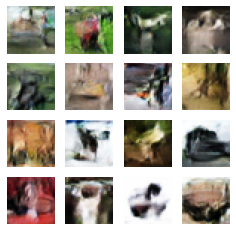

Time for training : 18929 sec


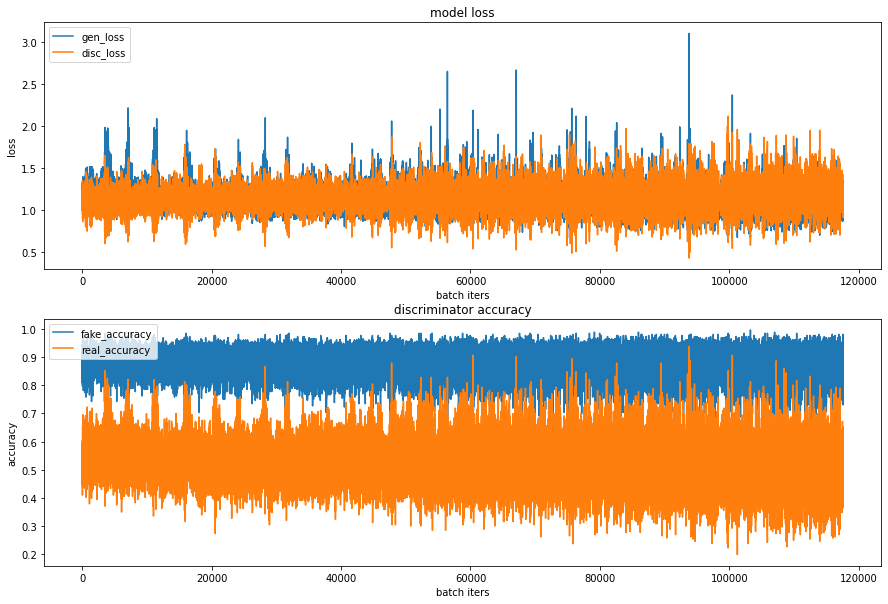

In [35]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

save_every = 5
EPOCHS = 600

train(train_dataset, EPOCHS, save_every)

In [36]:
anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_05.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l ~/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_05.gif

-rw-r--r-- 1 root root 4210232 Nov 15 00:02 /aiffel/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_05.gif


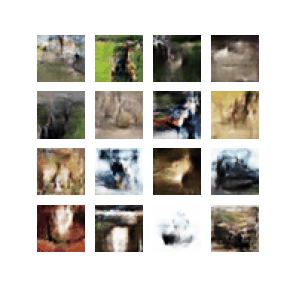

### 7-5. GAN 개선 과정 정리

#### 0차 시도 (lr = 0.001, epoch = 50)
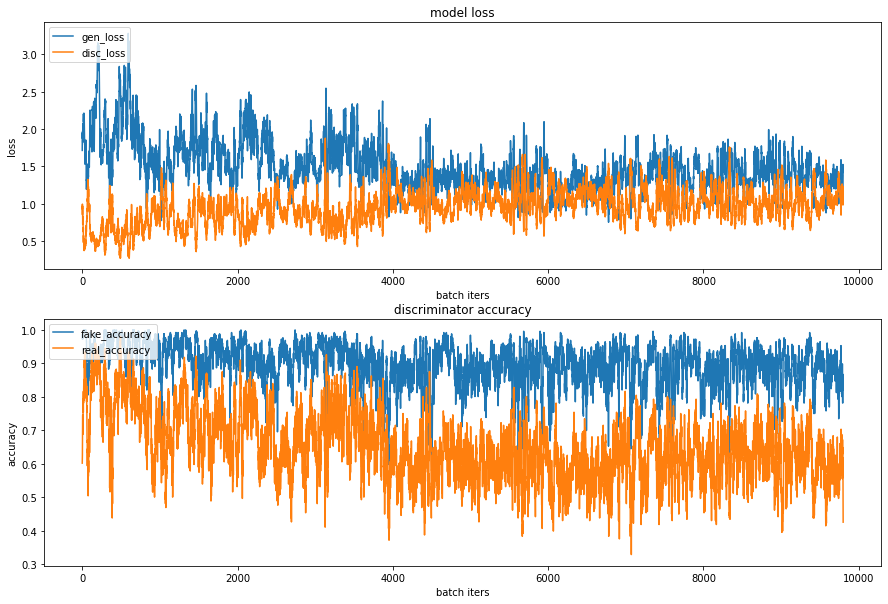
(쥬피터 상에선 그래프가 날라갔으나, vs 코드에 저장해둔 파일엔 그래프가 살아 있어서 첨부하였습니다.)

- 학습이 성공적으로 진행 되었는지에 대한 척도로는, 생성자가 만든 Fake Image에 대한 판별자의 Accuracy(fake_accuracy)가 1에서 멀어질수록 학습이 성공적으로 진행 되었음을 의미 합니다.

- 즉, 위의 그래프를 보면 fake_accuracy (성공률)이 0.9 언저리에 분포 되어 있으므로, 생성자가 만든 이미지가 아직 판별자를 성공적으로 속이지 못하고 있다는 것을 확인 할 수 있습니다.

#### 1차 시도 (lr = 0.001, epoch = 100)
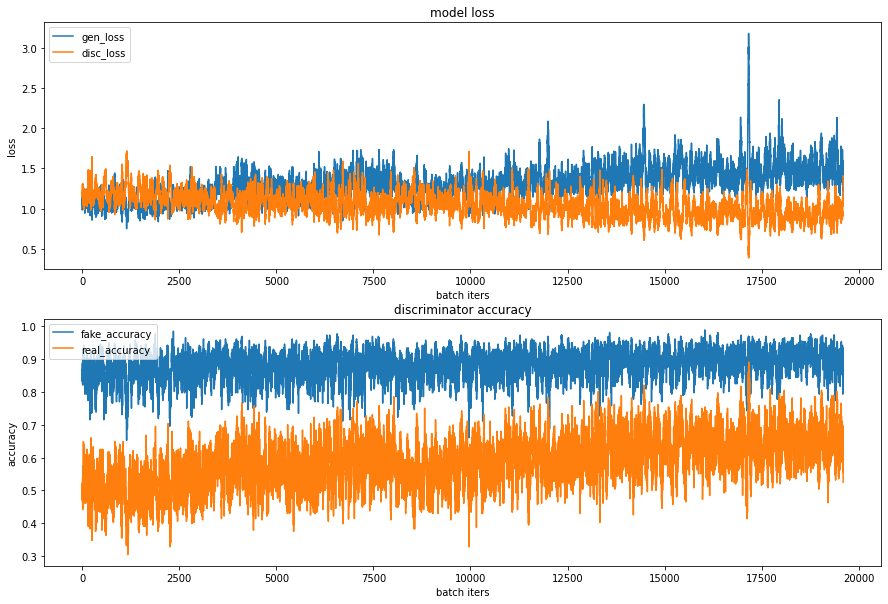
- epoch 수를 50에서 100으로 개선 시키면서, model의 loss 영역이 거의 균일 해졌음을 확인 할 수 있었으며, epoch 가 50일 때에 비해서, 상대적으로 fake_accuracy가 1에서 부터 조금 더 멀어졌음을 확인 할 수 있었습니다.

#### 개선 2 (lr = 0.002, epoch = 50)

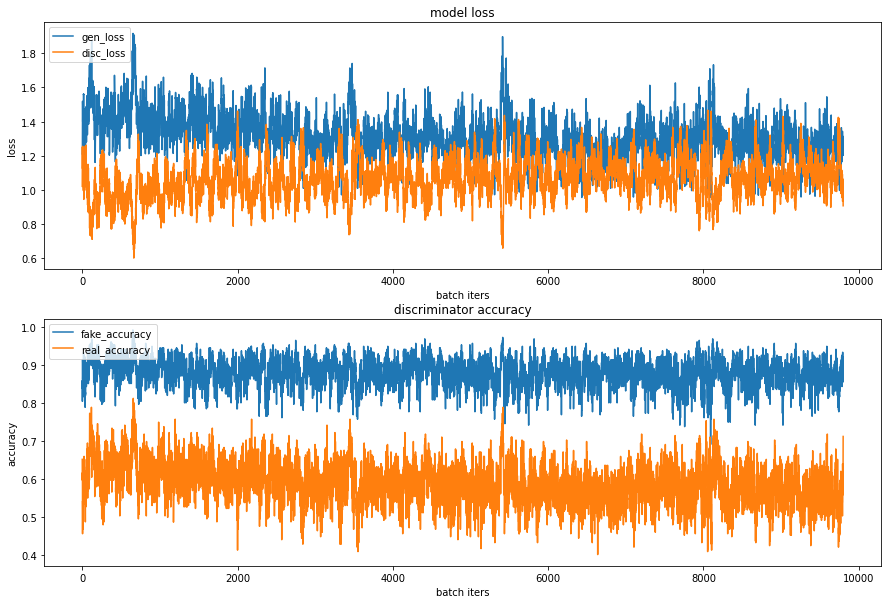

- 개선 1과 다르게 epoch 수가 50으로 줄고, lr을 0.002로 늘리면서 model_loss 값이 2.0 이하로 내려오고, fake_accuracy가 epoch를 100으로 했을 때와 유사해짐으로서, epoch 를 2배로 늘리는 것 만큼이나 lr도 모델의 loss나 accuracy에 영향을 미침을 확인 할 수 있었습니다.

#### ### 7-3. 개선 3 (lr = 0.001, epoch = 500)

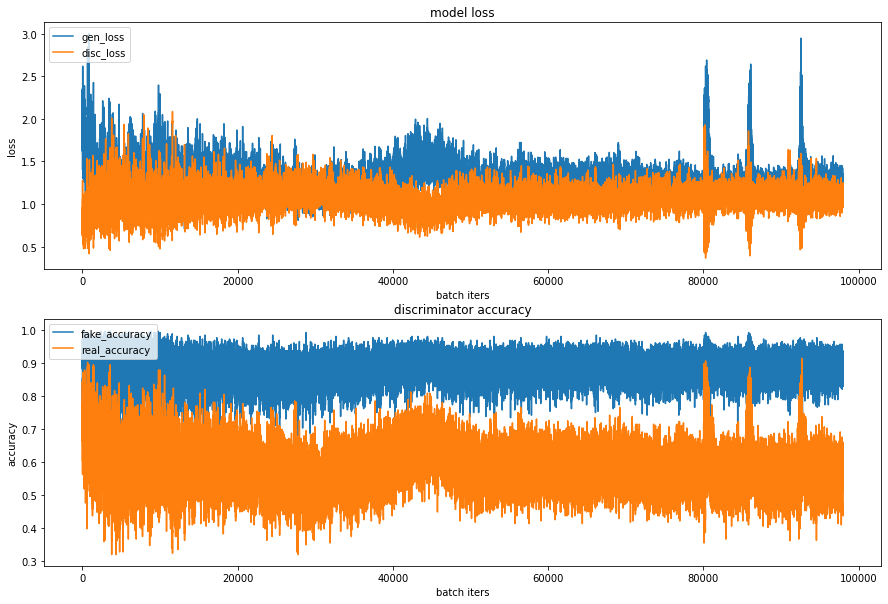

- epoch 값을 500으로 급격히 올리면서, model_loss가 종종 3.0 까지 튈 때도 있었지만, 추후에 1.5 내외로 안정화 됨을 확인 할 수 있었고, model_accuracy는 안정적으로 0.8 내외까지 나옴을 확인 할 수 있었습니다.

#### 7-4. 개선 4 (lr = 0.002, epoch = 600)

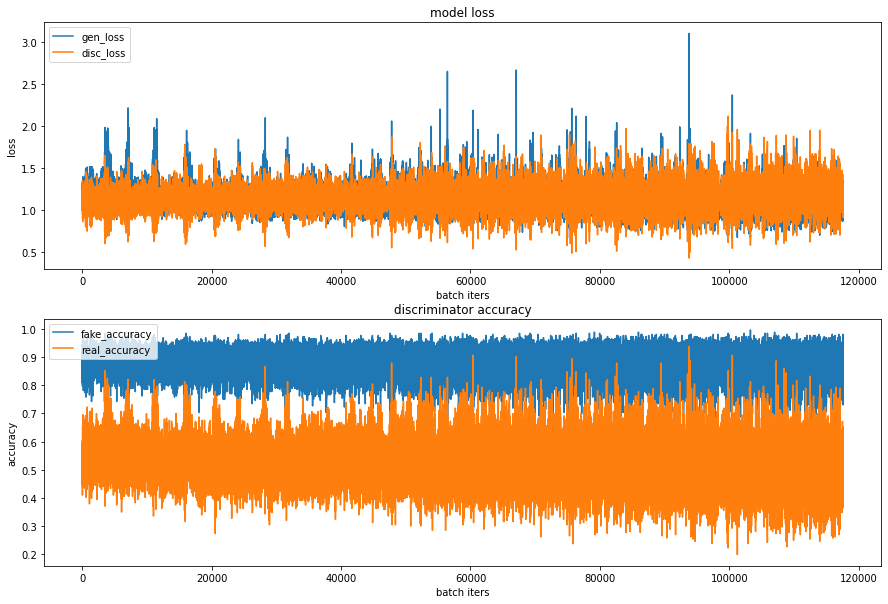

- 위에서 조정한 파라미터 (lr, epoch)를 둘 다 조정함으로서, model_accuracy가 초기에 비해서는 많이 1에서 멀어지기는 하였으나, 목표로 했었던 0.5 이하라는 수치에는 근접하지 못 하였습니다.

- 개선 4까지 진행하였음에도 출력된 이미지가 제대로 생성 되지 않은 것을 보면, 제대로 된 이미지를 생성하기 위해선 더 많은 epochs가 아닌 다른 변수를 조정해야 할 것이라는 insight를 남겼습니다.

## STEP 8. 루브릭 & 회고

### 루브릭

아래의 기준을 바탕으로 프로젝트를 평가합니다.

평가문항 상세기준

1. GAN의 두 모델 구조를 통해 이미지를 성공적으로 생성하였다.
- 오브젝트 종류를 육안으로 구별할 수 있을 만한 이미지를 생성하였다.
2. 생성 이미지 시각화 및 학습 그래프를 통해 GAN 학습이 바르게 진행되었음을 입증하였다.
- gif를 통해 생성이미지 품질이 서서히 향상되는 것과, fake accuracy가 추세적으로 0.5를 향해 하향하고 있음을 확인하였다.
3. 추가적인 GAN 모델구조 혹은 학습과정 개선 아이디어를 제안하고 이를 적용하였다.
- 제출 아이디어를 제출 프로젝트에 반영하고, 그 결과가 아이디어 적용 이전보다 향상되었음을 시각적으로 입증하였다.

### 회고

- 처음엔 GAN 이 정확하게 무엇인지 모르고 노드에 있는 내용을 따라가는 식으로 프로젝트를 진행하였습니다.

- 우선, 노드에 나온 epoch를 조정하면서 프로젝트를 진행하였지만, epoch 수만으로는 model_accuracy가 하향이 되지 않아서 다른 하이퍼파라미터를 조정해야함을 알게 되었고, 이에 lr을 조정하였음에도 목표로 했었던 fake accuracy가 0.5 이하로 하향 되거나 깔끔한 이미지를 생성 하지는 못하였습니다.

- 추가적으로 fake accuracy 를 0.5 이하로 하향 시켜야하는 의미가 개인적으로 궁금하였습니다.

- 이에 우수노드 (https://github.com/Jeon0866/AIFFEL_Project/blob/master/E13_CIFAR10_DCGAN.ipynb)를 참고 해보니 최적의 GAN 훈련 과정을 개선을 위해서,

     - generator_model에 use_bias=False 추가 & 마지막 활성화 함수에 Fifth: Conv2DTranspose layer에서 활성화 함수 tanh 추가
     - discriminator_model의 마지막 층에 활성화 함수 시그모이드 추가
     - optimizer 에서 generator_optimizer엔 epsilon=2e-07 개선
     - discriminator_optimizer에선 learning_rate=0.002, beta_1=0.5, epsilon=2e-07 개선 등

- 위에서의 다양한 파라미터와 optimizer 를 비롯한 다양한 요소들을 개선 한 것을 보며 이런 시도를 고려할 수가 있구나! 라는 꺠달음을 알게 되는 계기가 되었습니다.

- 매번 느끼는 것이었으나, 이번 프로젝트도 제가 부족한 것이 많구나... 라는 것을 깨닫는 계기가 되었던 거 같습니다.

- GAN 의 생성자와 판단자 모델이 서로 개선 시키는 방향으로 작동하는 구동 원리가 흥미로웠고, 이미지가 개선이 이루어지는 과정이 시각화를 통해 나타나는 것이 흥미로웠으나, 그 만큼 모델을 학습 시키느데 시간이 오려 걸려 한정된 시간 내에서 다양한 시도를 진행하는 것에는 한계가 있다는 것이 안타까웠습니다.

## 참고 레퍼런스
- https://github.com/Jeon0866/AIFFEL_Project/blob/master/E13_CIFAR10_DCGAN.ipynb
- https://github.com/hyyoo3526/AIFFEL_EXPLORATION/blob/main/EXPLORATION_13/EXPLORATION_IC1_13_dcgan_newimage.ipynb